<a href="https://colab.research.google.com/github/artman-industries/diffAE-image-editing/blob/main/diffae_image_editing_final.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# install packages

In [ ]:
!pip install pytorch_lightning
!pip install torch==1.7.1+cu110 torchvision==0.8.2+cu110 torchaudio==0.7.2  pytorch-lightning==1.2.2  torchtext==0.8.0 -f https://download.pytorch.org/whl/torch_stable.html
!pip install scipy==1.5.4
!pip install numpy
!pip install tqdm
!pip install pytorch-fid==0.2.0
!pip install pandas==1.1.5
!pip install lpips==0.1.4
!pip install lmdb==1.2.1
!pip install ftfy
!pip install regex
!pip install dlib requests

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 719.0/719.0 kB 22.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 519.2/519.2 kB 32.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 32.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 158.8/158.8 kB 20.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 114.2/114.2 kB 16.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 269.4/269.4 kB 32.8 MB/s eta 0:00:00
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in links: https://download.pytorch.org/whl/torch_stable.html
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 GB 1.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.8/12.8 MB 27.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.6/7.6 MB 93.2 MB/s eta 0:00:00
     ━━━━━━

In [ ]:
!git clone https://github.com/phizaz/diffae
!git pull https://github.com/phizaz/diffae



%cd 'diffae'

Cloning into 'diffae'...
remote: Enumerating objects: 484, done.
remote: Counting objects: 100% (89/89), done.
remote: Compressing objects: 100% (20/20), done.
remote: Total 484 (delta 72), reused 69 (delta 69), pack-reused 395
Receiving objects: 100% (484/484), 11.19 MiB | 26.65 MiB/s, done.
Resolving deltas: 100% (273/273), done.
fatal: not a git repository (or any of the parent directories): .git
/content/diffae


# imports & configuration

In [ ]:
import os
import os.path as osp
import matplotlib.pyplot as plt

from templates import *
from templates_cls import *
from experiment_classifier import ClsModel

In [ ]:
device = 'cuda:0'
model_config = ffhq256_autoenc()

In [ ]:
download_paths = {
        'diffae_weight': 'https://vistec-my.sharepoint.com/:u:/g/personal/nattanatc_pro_vistec_ac_th/ER56kn-uzlNAi39E1c784qQBkj5RI7-OAZC9QghQsIDQiQ?download=1' ,
        'diffae_latent':  'https://vistec-my.sharepoint.com/:u:/g/personal/nattanatc_pro_vistec_ac_th/EcZqHAWy2v9GuaXuESDg1tUB4li-hf0aC-2SjeLxB3ASdQ?download=1' ,
}

weight_dir_path = f'checkpoints/{model_config.name}'
if not osp.exists(weight_dir_path): os.makedirs(weight_dir_path)

model_download_path = download_paths['diffae_weight']
latents_download_path = download_paths['diffae_latent']

!wget -O '{weight_dir_path}/last.ckpt' '{model_download_path}'
!wget -O '{weight_dir_path}/latent.pkl' '{latents_download_path}'

--2023-04-27 07:50:33--  https://vistec-my.sharepoint.com/:u:/g/personal/nattanatc_pro_vistec_ac_th/ER56kn-uzlNAi39E1c784qQBkj5RI7-OAZC9QghQsIDQiQ?download=1
Resolving vistec-my.sharepoint.com (vistec-my.sharepoint.com)... 13.107.136.8, 13.107.138.8, 2620:1ec:8f8::8, ...
Connecting to vistec-my.sharepoint.com (vistec-my.sharepoint.com)|13.107.136.8|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: /personal/nattanatc_pro_vistec_ac_th/Documents/diffae-public/checkpoints/ffhq256_autoenc/last.ckpt?ga=1 [following]
--2023-04-27 07:50:34--  https://vistec-my.sharepoint.com/personal/nattanatc_pro_vistec_ac_th/Documents/diffae-public/checkpoints/ffhq256_autoenc/last.ckpt?ga=1
Reusing existing connection to vistec-my.sharepoint.com:443.
HTTP request sent, awaiting response... 200 OK
Length: 2722085968 (2.5G) [application/octet-stream]
Saving to: ‘checkpoints/ffhq256_autoenc/last.ckpt’

checkpoints/ffhq256 100%[===================>]   2.53G  52.5MB/s    in 63s     


# load the model

In [ ]:
print(model_config.name)
model = LitModel(model_config)
state = torch.load(f'checkpoints/{model_config.name}/last.ckpt', map_location='cpu')
model.load_state_dict(state['state_dict'], strict=False)
model.ema_model.eval()
model.ema_model.to(device);

INFO:lightning_fabric.utilities.seed:Global seed set to 0


ffhq256_autoenc
Model params: 160.69 M


# upload images

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
def process_images_in_folder(folder_path, path_to):
  if not osp.exists(path_to) : os.makedirs(path_to)
  !python align.py -i '{folder_path}' -o '{path_to}'

upload manualy the images from the attached folder !!

In [ ]:
examples_path = '/content/drive/MyDrive/technion/diff/photos/examples'
targets_path = '/content/drive/MyDrive/technion/diff/photos/targets'

examples_folders = [x[0] for x in os.walk(examples_path)]
examples_folders.remove(examples_path)
examples_folders

['/content/drive/MyDrive/technion/diff/photos/examples/fos',
 '/content/drive/MyDrive/technion/diff/photos/examples/nitzan']

In [ ]:
for name in examples_folders:
  process_images_in_folder(name, os.path.join('processed_images', name.split('/')[-1])) 

total img files 7
100% 7/7 [00:10<00:00,  1.55s/it]
output aligned images at: processed_images/fos
cached
cached
total img files 7
100% 7/7 [00:13<00:00,  1.89s/it]
output aligned images at: processed_images/nitzan


process test set

In [ ]:
test_set_to = os.path.join('processed_images', 'targets')
!python align.py -i '{targets_path}' -o '{test_set_to}'

cached
cached
total img files 6
100% 6/6 [00:08<00:00,  1.36s/it]
output aligned images at: processed_images/targets


# create dataset


In [ ]:
def convert_index_to_attribute(index):
  if index==0:
    return 'eyes_left'
  if index==1:
    return 'face_right'
  if index==2:
    return 'glasses'
  if index==3:
    return 'eyes_right'
  if index==4:
    return 'face_left'
  if index==5:
    return 'smile'
  if index==6:
    return 'reg'
  return 'not valid'

def convert_attribute_to_index(attribute):
  if attribute=='glasses':
    return 0
  if attribute=='face_left':
    return 1
  if attribute=='eyes_left':
    return 2
  if attribute=='eyes_right':
    return 3
  if attribute=='face_right':
    return 4
  if attribute=='smile':
    return 5
  if attribute=='reg':
    return 6
  return 'not valid'

class Example():
  def __init__(self, dataset) -> None:
    self.dataset = dataset
  
  def origin(self):
    return self.dataset[convert_attribute_to_index('reg')]
  
  def get_attribute_by_name(self, name):
    return self.dataset[convert_attribute_to_index(name)]

  def get_all_variations(self):
    reg_index = convert_attribute_to_index('reg')
    return self.dataset[:reg_index, reg_index+1:]

In [ ]:
def show_data(data):
  fig, ax = plt.subplots(1, len(data), figsize=(10, 5))
  for i, d in enumerate(data):
    ax[i].imshow(d['img'][None][0].permute([1, 2, 0]) / 2 + 0.5)
    ax[i].set_title(i)
    # ax[i].set_title(f'{i} - {convert_index_to_attribute(i)}')

In [ ]:
dataset = {}
examples = {}
for path_to_folder in examples_folders:
  name = path_to_folder.split('/')[-1]
  dataset[name] = ImageDataset(os.path.join('processed_images', name), image_size=model_config.img_size, exts=['jpg', 'JPG', 'png'], do_augment=False)
  examples[name] = Example(dataset[name])

fos
nitzan


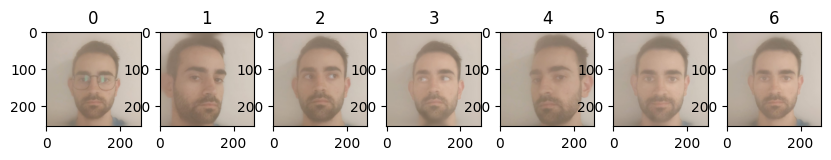

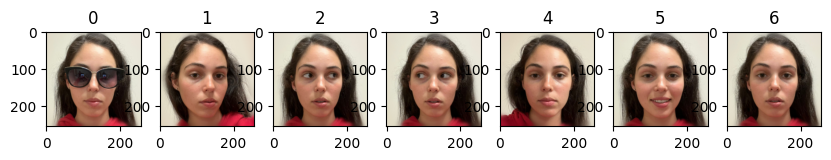

In [ ]:
for k,v in dataset.items():
  print(k)
  show_data(v)

In [ ]:
targets_dataset = ImageDataset(os.path.join('processed_images', 'targets'), image_size=model_config.img_size, exts=['jpg', 'JPG', 'png'], do_augment=False)

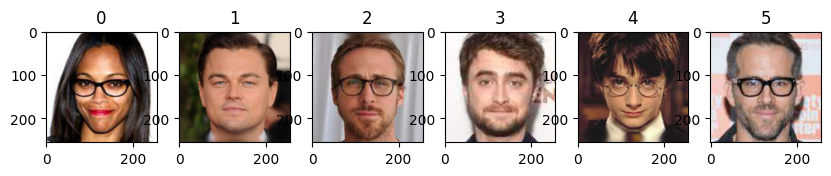

In [ ]:
show_data(targets_dataset)

# playground 


In [ ]:
person = 'nitzan'

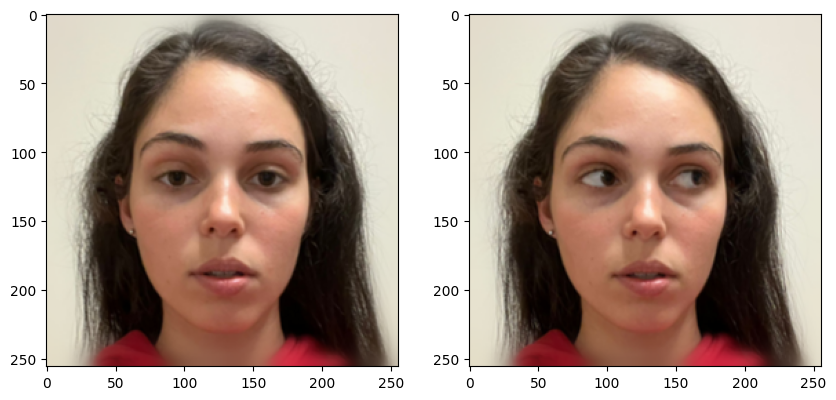

In [ ]:
fig, ax = plt.subplots(1, 2, figsize=(10, 5))

batch0 = examples[person].origin()['img'][None] # dataset[person][reg_index]['img'][None]
batch1 = examples[person].get_attribute_by_name('eyes_left')['img'][None] # dataset[person][eyes_left_index]['img'][None]
ax[0].imshow(batch0[0].permute([1, 2, 0]) / 2 + 0.5)
ax[1].imshow(batch1[0].permute([1, 2, 0]) / 2 + 0.5)

In [ ]:
cond0 = model.encode(batch0.to(device))
xT0 = model.encode_stochastic(batch0.to(device), cond0, T=250)

cond1 = model.encode(batch1.to(device))
xT1 = model.encode_stochastic(batch1.to(device), cond1, T=250)

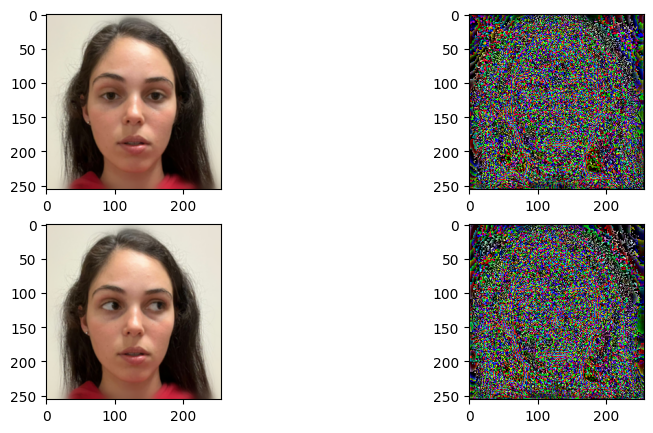

In [ ]:
import matplotlib.pyplot as plt
fig, ax = plt.subplots(2, 2, figsize=(10, 5))
ori0 = (batch0 + 1) / 2
ax[0,0].imshow(ori0[0].permute(1, 2, 0).cpu())
ax[0,1].imshow(xT0[0].permute(1, 2, 0).cpu())

ori1 = (batch1 + 1) / 2
ax[1,0].imshow(ori1[0].permute(1, 2, 0).cpu())
ax[1,1].imshow(xT1[0].permute(1, 2, 0).cpu())

In [ ]:
leo = targets_dataset[1]['img'][None]
cond_leo = model.encode(leo.to(device))
xT_leo = model.encode_stochastic(leo.to(device), cond_leo, T=250)

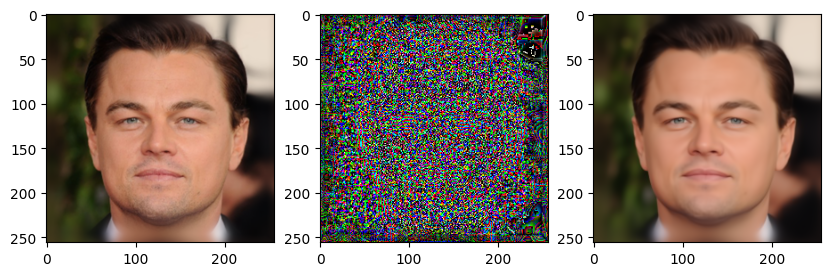

In [ ]:
pred = model.render(xT_leo, cond_leo, T=20)
fig, ax = plt.subplots(1, 3, figsize=(10, 5))
ori = (leo + 1) / 2
ax[0].imshow(ori[0].permute(1, 2, 0).cpu())
ax[1].imshow(xT_leo[0].permute(1, 2, 0).cpu())
ax[2].imshow(pred[0].permute(1, 2, 0).cpu())

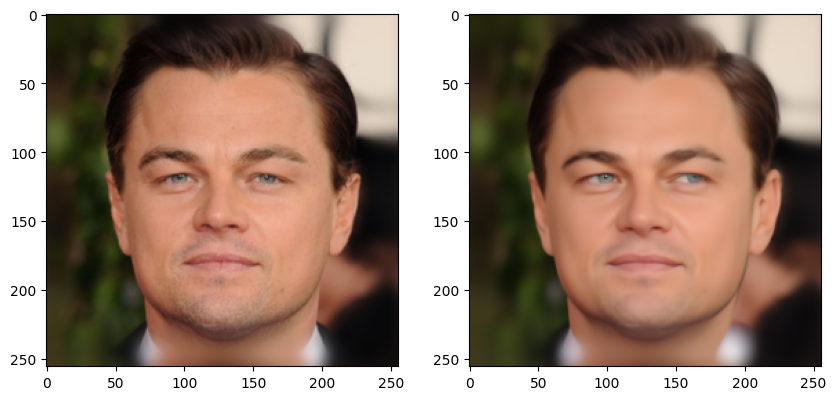

In [ ]:
alpha = 0.5
beta = 0

diff_c = cond1-cond0
diff_x = xT1-xT0

cond = cond_leo + alpha * diff_c
xT = xT_leo + beta*diff_x

pred = model.render(xT, cond, T=20)
fig, ax = plt.subplots(1, 2, figsize=(10, 5))
ori = (leo + 1) / 2
ax[0].imshow(ori[0].permute(1, 2, 0).cpu())
ax[1].imshow(pred[0].permute(1, 2, 0).cpu())

# image editing


## process images

In [ ]:
def process_images(data, indexes, display_images=True, figsize=(10, 5)):
  if display_images:  
    fig, ax = plt.subplots(len(indexes), 3, figsize=figsize)
  encoding_list = []
  for i, index in enumerate(indexes):
    encoding = {}
    batch0 = data[index]['img'][None]
    ori0 = (batch0 + 1) / 2

    cond0 = model.encode(batch0.to(device))
    xT0 = model.encode_stochastic(batch0.to(device), cond0, T=250)
    encoding['cond'] = cond0
    encoding['xT'] = xT0
    
    if display_images:
      reconstruction = model.render(xT0, cond0, T=20)
      
      ax[i,0].imshow(ori0[0].permute(1, 2, 0).cpu())
      ax[i,1].imshow(xT0[0].permute(1, 2, 0).cpu())
      ax[i,2].imshow(reconstruction[0].permute(1, 2, 0).cpu())  
    encoding_list.append(encoding)
  return encoding_list

fos


nitzan


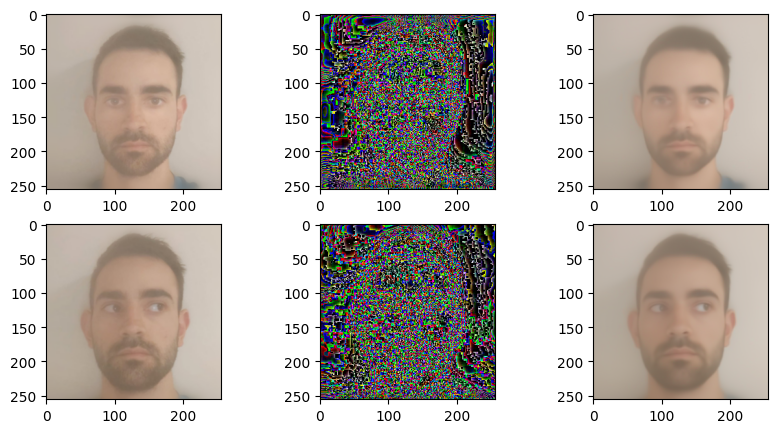

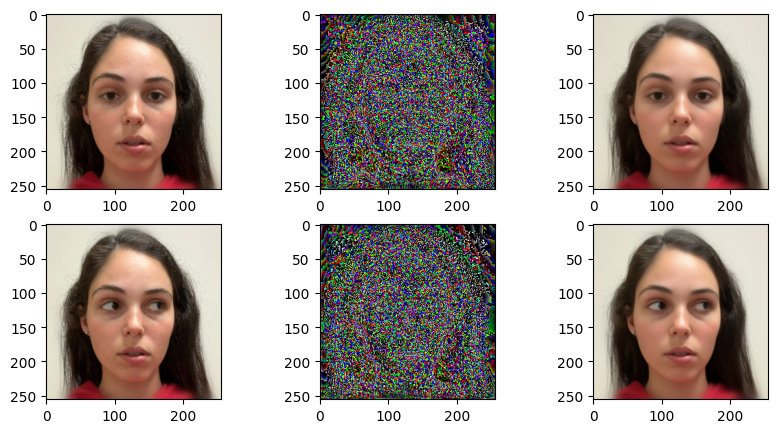

In [ ]:
reg_index = convert_attribute_to_index('reg')
eyes_left_index = convert_attribute_to_index('eyes_left')
indexes = [reg_index, eyes_left_index]

encoding = {}
for k,v in dataset.items():
  print(k)
  print(v)
  enc = process_images(v, indexes)
  encoding[k] = enc

## generate images - select the best looking example

In [ ]:
def generate_image(img1_dict, img2_dict, target_img_dict, alpha=1, T=20):
  cond1 = img1_dict['cond']
  xT1 = img1_dict['xT']

  cond2 = img2_dict['cond']
  xT2 = img2_dict['xT']

  target_cond = target_img_dict['cond']
  target_xT = target_img_dict['xT']

  diff_c = cond2-cond1

  cond = target_cond + alpha * diff_c
  xT = target_xT
  pred = model.render(xT, cond, T=T)
  return pred

In [ ]:
target_img_dict = {'cond': cond_leo, 'xT': xT_leo}

fos
nitzan


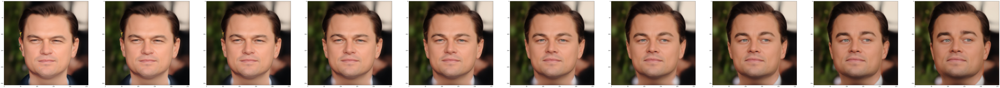

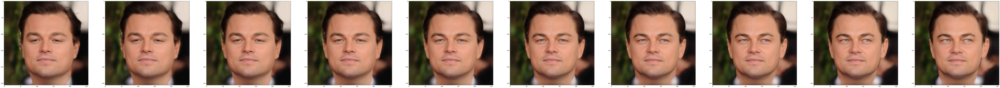

In [ ]:
for k,v in encoding.items():
  print(k)
  rng = np.arange(-1, 1.0, 0.2)
  fig, ax = plt.subplots(1, len(rng), figsize=(150, 40))
  for i, alpha in enumerate(rng):
    img = generate_image(v[0], v[1], target_img_dict, alpha=alpha)
    ax[i].imshow(img[0].permute(1, 2, 0).cpu())

we can clearly see that nitzan have mutch better representation. our next work will be with her

## generate images with the best example

In [ ]:
nitzan_enc = process_images(dataset['nitzan'], range(0, len(dataset['nitzan'])), display_images=False)

In [ ]:
generated_images = []

In [ ]:
for i in range(0, len((dataset['nitzan']))):
  print(f'{i}: {convert_index_to_attribute(i)}')

0: eyes_left
1: face_right
2: glasses
3: eyes_right
4: face_left
5: smile
6: reg


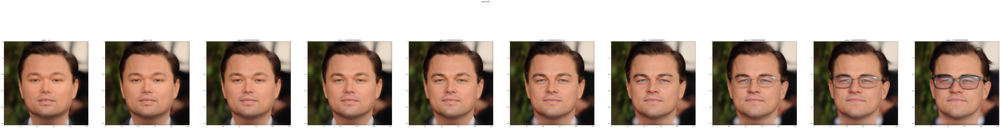

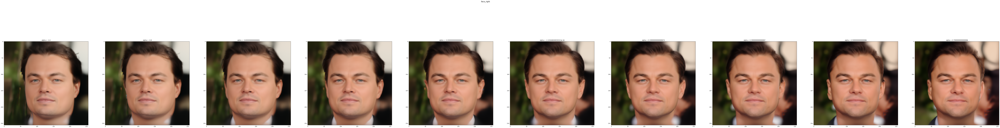

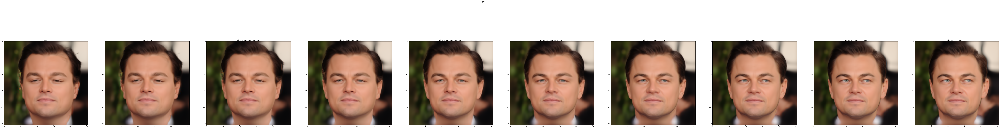

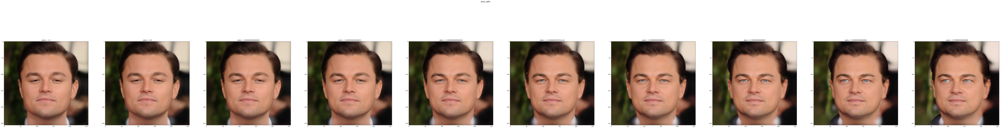

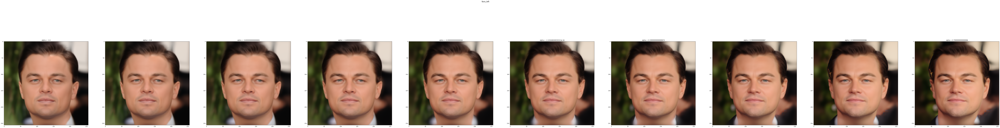

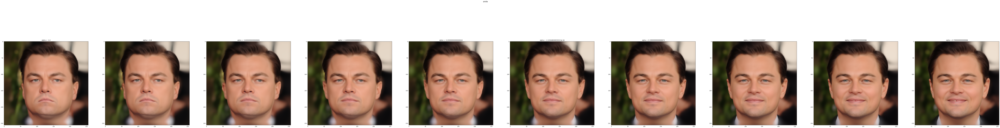

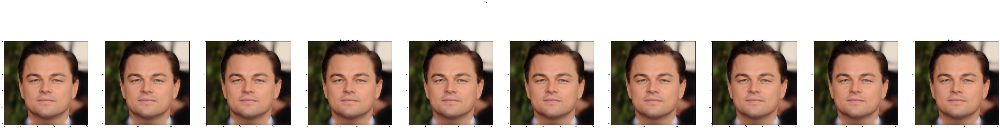

In [ ]:
rng = np.arange(-1.0, 1.0, 0.2)

for i in range(0, len(dataset['nitzan'])):
  generated_images.append([])
  fig, ax = plt.subplots(1, len(rng), figsize=(150, 20))
  fig.suptitle(convert_index_to_attribute(i), fontsize=15)
  for k, alpha in enumerate(rng):
    img = generate_image(nitzan_enc[reg_index], nitzan_enc[i], target_img_dict, alpha=alpha)
    generated_images[i-1].append(img)
    ax[k].imshow(img[0].permute(1, 2, 0).cpu())
    ax[k].set_title(f'alpha = {alpha}')

## selected results

In [ ]:
def display_images(target_img, new_img):
  fig, ax = plt.subplots(1, 2, figsize=(10, 5))
  ori = (target_img + 1) / 2
  ax[0].imshow(ori[0].permute(1, 2, 0).cpu())
  ax[1].imshow(new_img[0].permute(1, 2, 0).cpu())

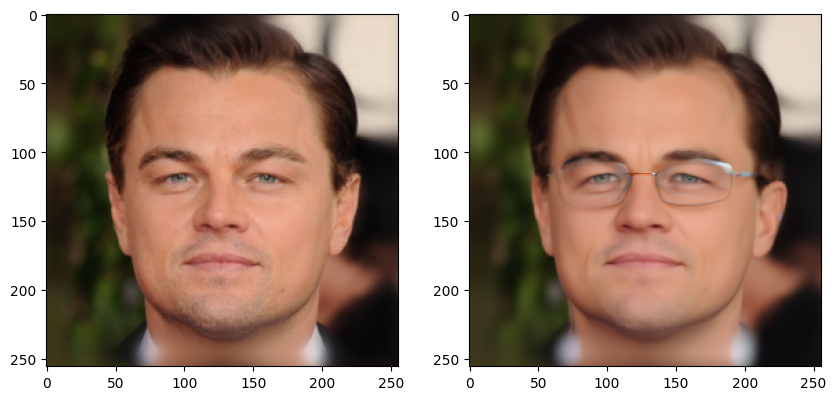

In [ ]:
glasses_index = convert_attribute_to_index('glasses')
leo_glasses = generate_image(nitzan_enc[reg_index], nitzan_enc[glasses_index], target_img_dict, T=20, alpha=0.4)
display_images(leo, leo_glasses)

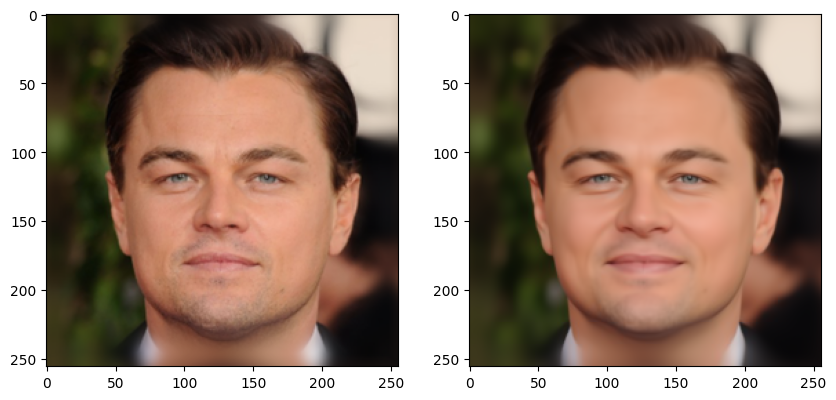

In [ ]:
smile_index = convert_attribute_to_index('smile')
leo_smile = generate_image(nitzan_enc[reg_index], nitzan_enc[smile_index], target_img_dict, T=20, alpha=0.5)
display_images(leo, leo_smile)

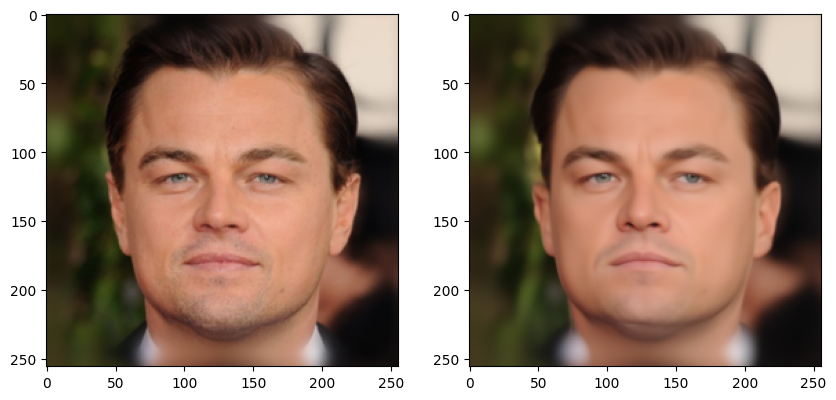

In [ ]:
leo_smile = generate_image(nitzan_enc[reg_index], nitzan_enc[smile_index], target_img_dict, T=20, alpha=-0.5)
display_images(leo, leo_smile)

the next results are very interesting. the added smile has attributes of a woman so adding the smile vector on large scale also changes the gender.

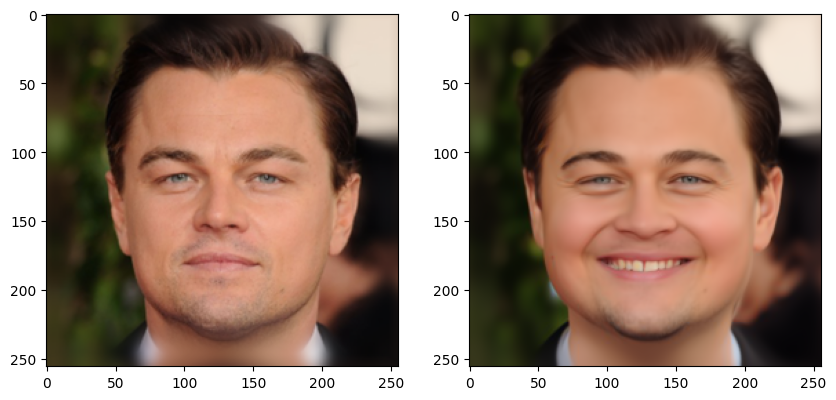

In [ ]:
leo_smile = generate_image(nitzan_enc[reg_index], nitzan_enc[smile_index], target_img_dict, T=20, alpha=2)
display_images(leo, leo_smile)

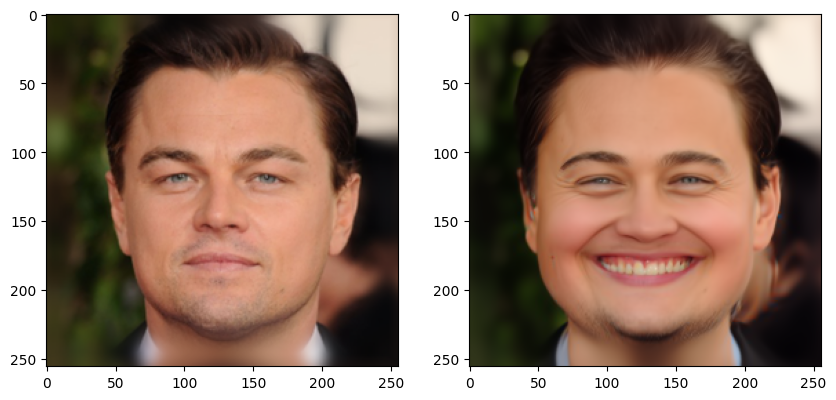

In [ ]:
leo_smile = generate_image(nitzan_enc[reg_index], nitzan_enc[smile_index], target_img_dict, T=20, alpha=3.5)
display_images(leo, leo_smile)

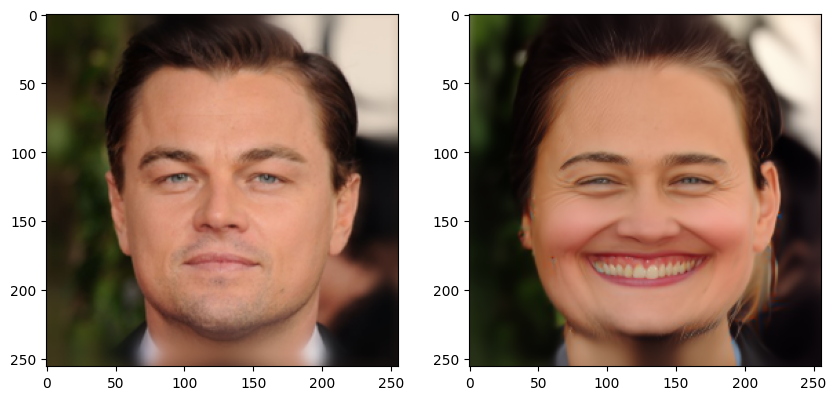

In [ ]:
leo_smile = generate_image(nitzan_enc[reg_index], nitzan_enc[smile_index], target_img_dict, T=20, alpha=5)
display_images(leo, leo_smile)

here we will make leo look left & right using the same "eyes looking left" label 

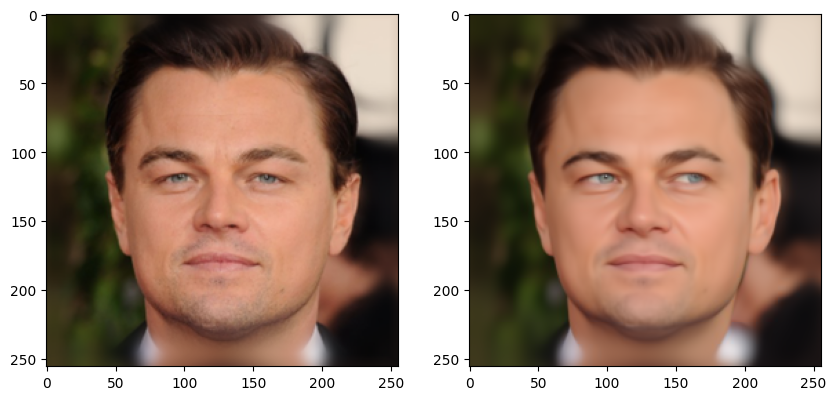

In [ ]:
eyes_left_index = convert_attribute_to_index('eyes_left')
leo_left = generate_image(nitzan_enc[reg_index], nitzan_enc[eyes_left_index], target_img_dict, T=20, alpha=0.7)
display_images(leo, leo_left)

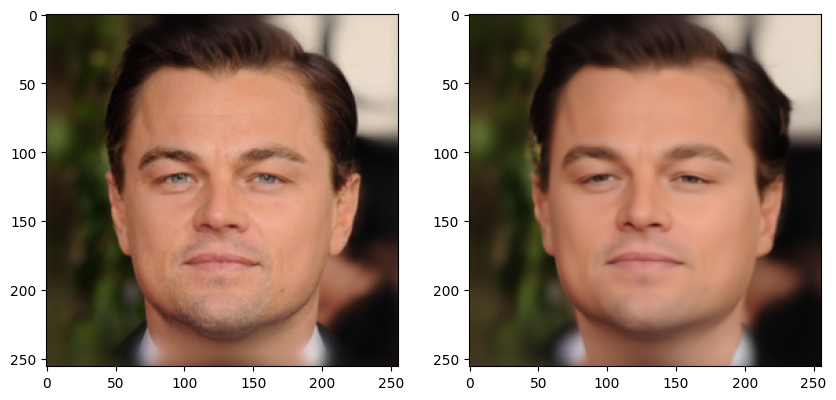

In [ ]:
leo_left = generate_image(nitzan_enc[reg_index], nitzan_enc[eyes_left_index], target_img_dict, T=20, alpha=-0.7)
display_images(leo, leo_left)

here we will make leo look left & right using the same "eyes looking right" label 

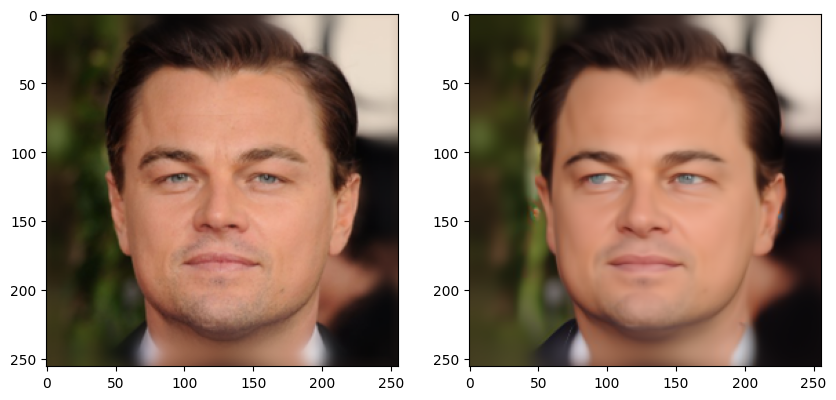

In [ ]:
eyes_right_index = convert_attribute_to_index('eyes_right')
leo_right = generate_image(nitzan_enc[reg_index], nitzan_enc[eyes_right_index], target_img_dict, T=20, alpha=0.7)
display_images(leo, leo_right)

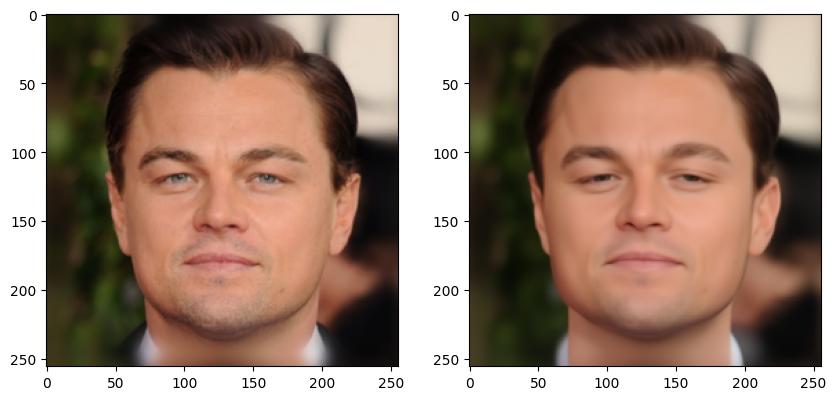

In [ ]:
leo_right = generate_image(nitzan_enc[reg_index], nitzan_enc[eyes_right_index], target_img_dict, T=20, alpha=-0.7)
display_images(leo, leo_right)

removing glasses

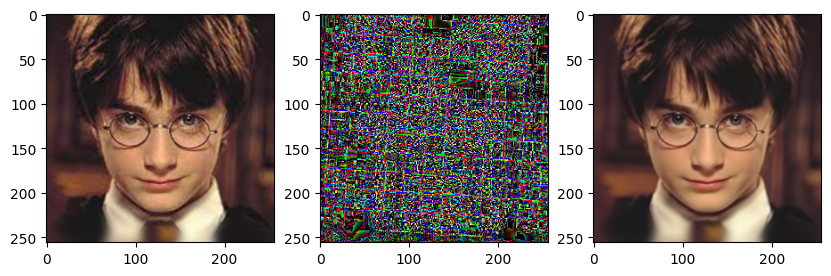

In [ ]:
harry = targets_dataset[4]['img'][None]
cond_harry = model.encode(harry.to(device))
xT_harry = model.encode_stochastic(harry.to(device), cond_harry, T=250)

pred = model.render(xT_harry, cond_harry, T=20)
fig, ax = plt.subplots(1, 3, figsize=(10, 5))
ori = (harry + 1) / 2
ax[0].imshow(ori[0].permute(1, 2, 0).cpu())
ax[1].imshow(xT_harry[0].permute(1, 2, 0).cpu())
ax[2].imshow(pred[0].permute(1, 2, 0).cpu())

In [ ]:
harry_img_dict = {'cond': cond_harry, 'xT': xT_harry}

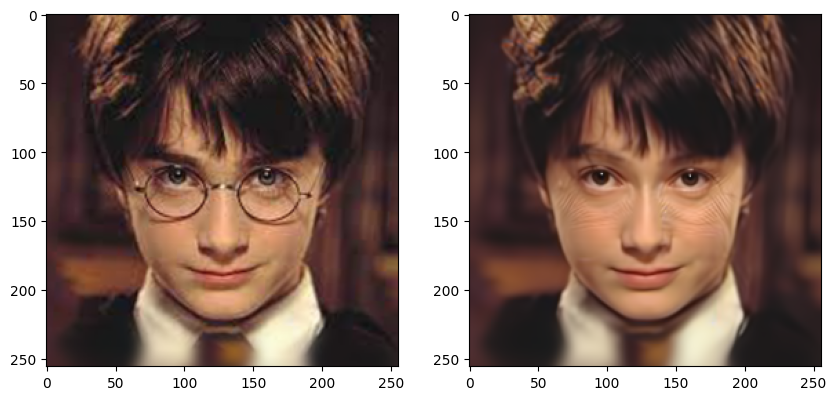

In [ ]:
harry_glasses = generate_image(nitzan_enc[reg_index], nitzan_enc[glasses_index], harry_img_dict, T=20, alpha=-0.5)
display_images(harry, harry_glasses)

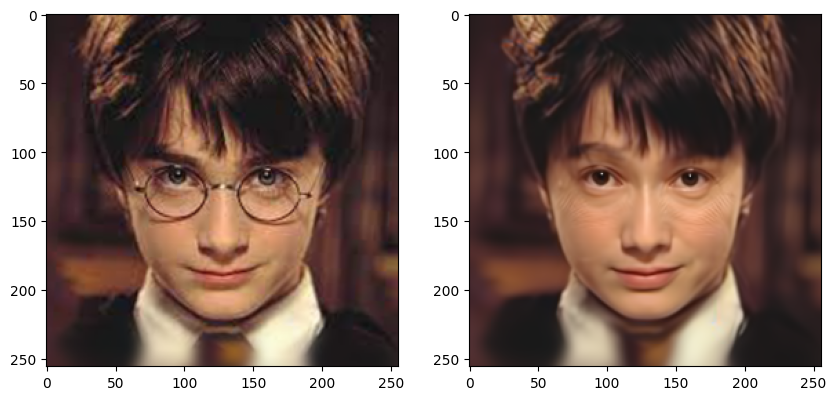

In [ ]:
harry_glasses = generate_image(nitzan_enc[reg_index], nitzan_enc[glasses_index], harry_img_dict, T=20, alpha=-0.7)
display_images(harry, harry_glasses)

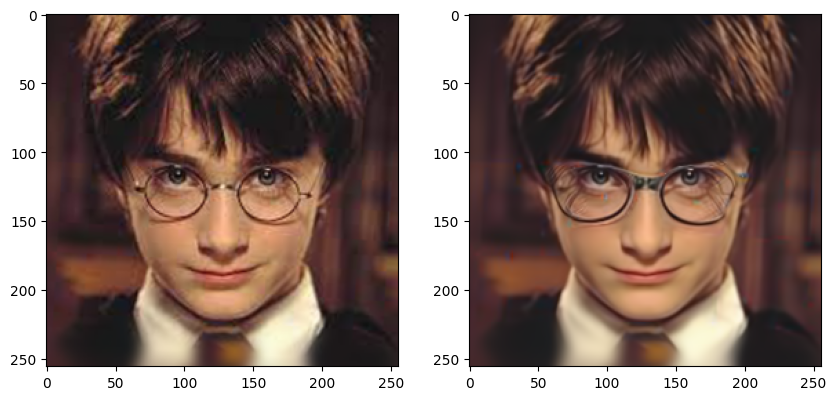

In [ ]:
harry_glasses = generate_image(nitzan_enc[reg_index], nitzan_enc[glasses_index], harry_img_dict, T=20, alpha=0.3)
display_images(harry, harry_glasses)

lets try removing glasses for target that is more close to the learned distribution

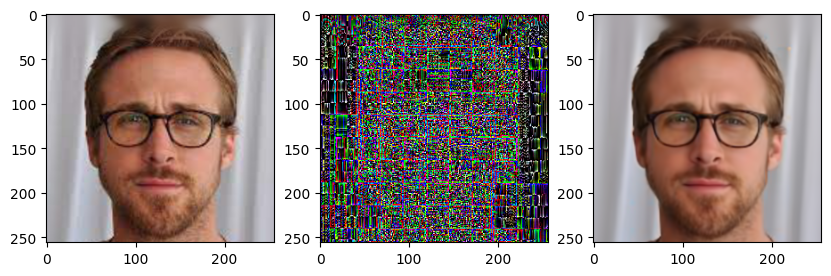

In [ ]:
target2 = targets_dataset[2]['img'][None]
cond_target2 = model.encode(target2.to(device))
xT_target2 = model.encode_stochastic(target2.to(device), cond_target2, T=250)

pred = model.render(xT_target2, cond_target2, T=20)
fig, ax = plt.subplots(1, 3, figsize=(10, 5))
ori = (target2 + 1) / 2
ax[0].imshow(ori[0].permute(1, 2, 0).cpu())
ax[1].imshow(xT_target2[0].permute(1, 2, 0).cpu())
ax[2].imshow(pred[0].permute(1, 2, 0).cpu())

In [ ]:
target2_img_dict = {'cond': cond_target2, 'xT': xT_target2}

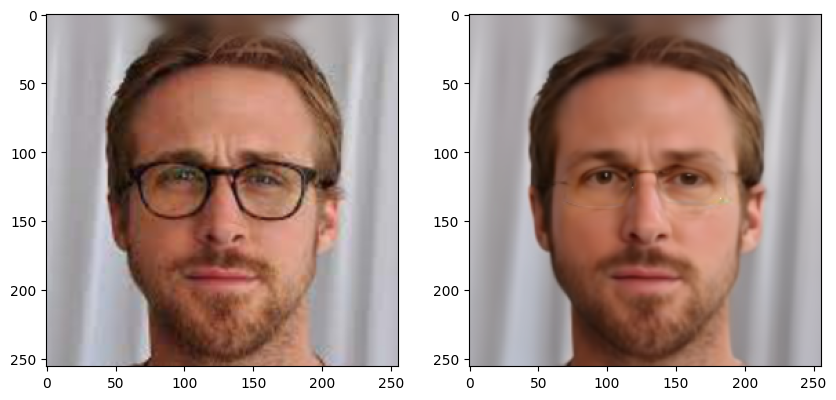

In [ ]:
target2_glasses = generate_image(nitzan_enc[reg_index], nitzan_enc[glasses_index], target2_img_dict, T=20, alpha=-0.7)
display_images(target2, target2_glasses)

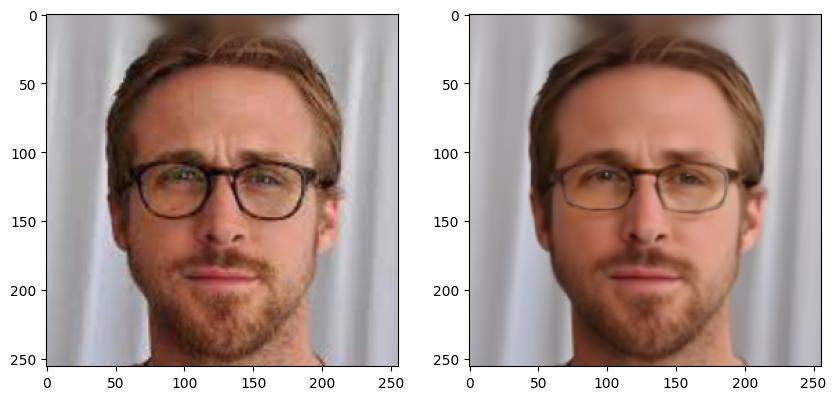

In [ ]:
target2_glasses = generate_image(nitzan_enc[reg_index], nitzan_enc[glasses_index], target2_img_dict, T=20, alpha=-0.4)
display_images(target2, target2_glasses)

## multiple attribute changes

add glasses & look left (on 3 different targets)

In [ ]:
def generate_image_from_list(img1_dict, img2_list_dict, target_img_dict, alpha=1, T=20):
  cond1 = img1_dict['cond']
  xT1 = img1_dict['xT']

  cond2 = [img2_dict['cond'] for img2_dict in img2_list_dict]
  xT2 = [img2_dict['xT'] for img2_dict in img2_list_dict]

  target_cond = target_img_dict['cond']
  target_xT = target_img_dict['xT']

  diff_c = torch.zeros(cond1.shape).to(device)
  for cond_d in cond2:
    diff_c = diff_c + (cond_d - cond1) 
  # diff_c = diff_c / len(cond2)
  
  cond = target_cond + alpha * diff_c
  xT = target_xT
  pred = model.render(xT, cond, T=T)
  return pred

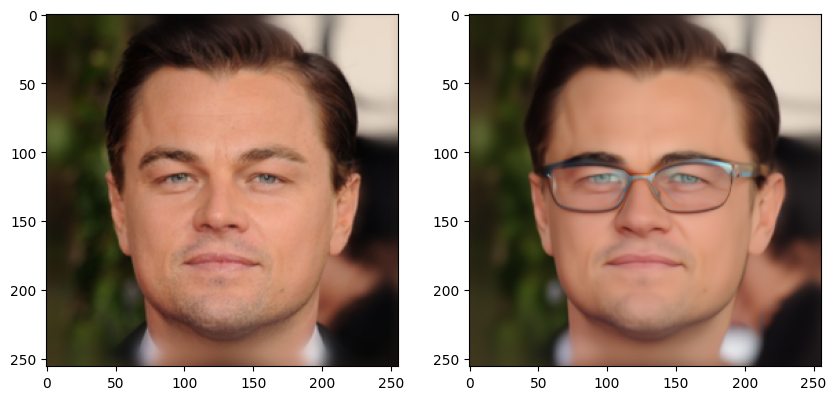

In [ ]:
leo_right = generate_image_from_list(nitzan_enc[reg_index], [nitzan_enc[glasses_index], nitzan_enc[eyes_left_index]], target_img_dict, T=20, alpha=0.6)
display_images(leo, leo_right)

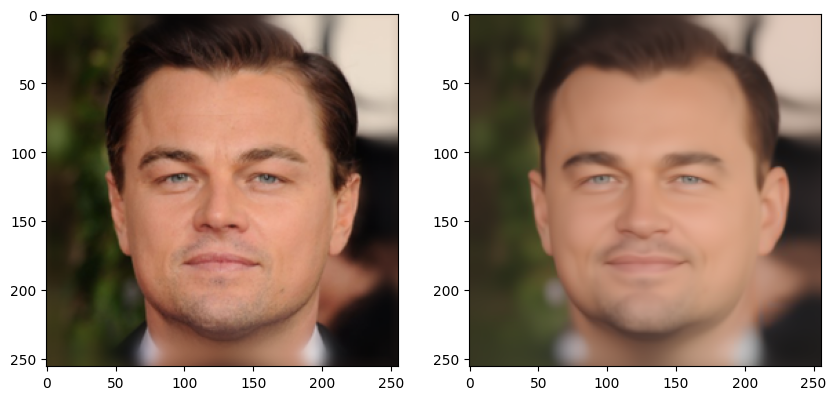

In [ ]:
leo_right = generate_image_from_list(nitzan_enc[0], [nitzan_enc[4], fos_enc[4]], target_img_dict, T=20, alpha=0.6)
display_images(leo, leo_right)